In [1]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageEnhance, ImageFilter
import imageio
import torch
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

In [2]:
# Function to drastically reduce image size
def drastically_reduce_image_size(image, scale=0.3):
    """Reduce image size by a specified scale."""
    width = int(image.shape[1] * scale)
    height = int(image.shape[0] * scale)
    return cv2.resize(image, (width, height), interpolation=cv2.INTER_AREA)

In [3]:
# Function to extract, crop, and color the silhouette
def extract_and_color_silhouette(image, mask, color, opacity=0.3, blur_radius=2, use_blur=True):
    """Extract and color the silhouette with specified opacity and blur radius."""
    mask = mask.astype(np.uint8) * 255  # Convert mask to binary (0 or 255)
    silhouette = np.zeros((image.shape[0], image.shape[1], 4), dtype=np.uint8)
    cropped_image = np.zeros((image.shape[0], image.shape[1], 4), dtype=np.uint8)
    
    # Apply the mask to the original image and color the silhouette
    for c in range(3):  # For each color channel
        silhouette[:, :, c] = color[c] * (mask // 255)
        cropped_image[:, :, c] = image[:, :, c] * (mask // 255)
    
    silhouette[:, :, 3] = (mask * opacity).astype(np.uint8)  # Set alpha channel with opacity
    cropped_image[:, :, 3] = (mask * opacity).astype(np.uint8)  # Set alpha channel with opacity
    
    silhouette_img = Image.fromarray(silhouette)
    cropped_img = Image.fromarray(cropped_image)

    # Apply blur to the edges if use_blur is True
    if use_blur:
        silhouette_img = silhouette_img.filter(ImageFilter.GaussianBlur(blur_radius))
        cropped_img = cropped_img.filter(ImageFilter.GaussianBlur(blur_radius))

    return cropped_img, silhouette_img

In [4]:
# Function to combine the silhouette and colored mask
def combine_silhouette_and_mask(cropped_img, colored_mask):
    """Combine the silhouette and colored mask without fully obscuring the silhouette."""
    combined_img = Image.alpha_composite(colored_mask, cropped_img)
    return combined_img

In [5]:
# Generator function to process images in the input folder
def process_images(input_folder):
    """Yield images from the input folder."""
    all_images = sorted([img for img in os.listdir(input_folder) if img.endswith('.jpg') or img.endswith('.png')])
    for img_name in all_images:
        image_path = os.path.join(input_folder, img_name)
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Drastically reduce image size
        image_resized = drastically_reduce_image_size(image)
        
        yield img_name, image_resized

In [6]:
# Initialize Detectron2
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set the threshold for this model
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"  # Use CUDA if available

predictor = DefaultPredictor(cfg)

In [7]:
# Directory paths
input_folder = "Desktop/GoPro_testTechnique/testNoelia"
output_folder = "Desktop/GoPro_testTechnique/out_corrected2"
human_folder = "Desktop/GoPro_testTechnique/humans2"
background_folder = "Desktop/GoPro_testTechnique/backgrounds2"
os.makedirs(output_folder, exist_ok=True)
os.makedirs(human_folder, exist_ok=True)
os.makedirs(background_folder, exist_ok=True)

In [12]:
# Parameter to control blur radius and opacity
use_blur = True  # Set to False if you don't want to use blur
blur_radius = 0.2  # Adjust this value to change the blur effect on the edges
opacity = 0.8  # Adjust opacity as needed

# Create a list to hold GIF frames
gif_images = []

# Initialize accumulation variables
accumulated_silhouettes = None
previous_image_gray = None
previous_keypoints = None
previous_descriptors = None

# Initialize SIFT detector
sift = cv2.SIFT_create()

# Initialize BFMatcher
bf = cv2.BFMatcher()

In [13]:
# Process each image using the generator function
for img_name, image_resized in process_images(input_folder):
    image_gray = cv2.cvtColor(image_resized, cv2.COLOR_RGB2GRAY)

    if accumulated_silhouettes is None:
        # Initialize accumulation with the size of the first frame
        accumulated_silhouettes = Image.new("RGBA", (image_resized.shape[1], image_resized.shape[0]), (255, 255, 255, 0))
        previous_image_gray = image_gray
        previous_keypoints, previous_descriptors = sift.detectAndCompute(previous_image_gray, None)
        continue

    # Detect human silhouette
    outputs = predictor(image_resized)
    instances = outputs["instances"]
    human_masks = instances.pred_masks[instances.pred_classes == 0]  # Class 0 corresponds to 'person'

    if len(human_masks) > 0:
        human_mask = human_masks[0].cpu().numpy()
    else:
        continue  # Skip if no person detected

    # Extract and color the human silhouette
    color = (int(255 * np.random.random()), int(255 * np.random.random()), int(255 * np.random.random()))
    cropped_img, colored_silhouette = extract_and_color_silhouette(image_resized, human_mask, color, opacity, blur_radius, use_blur)

    # Save human and background images
    human_img_path = os.path.join(human_folder, f"human_{img_name}.png")
    background_img_path = os.path.join(background_folder, f"background_{img_name}.png")
    cropped_img.save(human_img_path)
    
    # Create the background image by masking out the human shapes
    inverted_mask = Image.fromarray((~human_mask * 255).astype(np.uint8))
    background_image = Image.fromarray(image_resized).convert("RGBA")
    background_image.paste((255, 255, 255, 0), (0, 0), mask=inverted_mask)
    background_image.save(background_img_path)

    # Detect keypoints and descriptors in the current image
    keypoints, descriptors = sift.detectAndCompute(image_gray, None)

    # Match descriptors
    matches = bf.knnMatch(previous_descriptors, descriptors, k=2)

    # Apply ratio test
    good_matches = []
    for m, n in matches:
        if m.distance < 0.75 * n.distance:
            good_matches.append(m)

    # Check if there are enough good matches
    if len(good_matches) >= 4:
        # Extract location of good matches
        points_previous = np.float32([previous_keypoints[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
        points_current = np.float32([keypoints[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)

        # Find homography
        H, mask = cv2.findHomography(points_current, points_previous, cv2.RANSAC, 5.0)

        # Warp the accumulated silhouettes to align with the current image
        accumulated_silhouettes = accumulated_silhouettes.transform(
            (image_resized.shape[1], image_resized.shape[0]),
            Image.PERSPECTIVE,
            data=H.flatten()[:8],
            resample=Image.BILINEAR
        )

    # Combine the colored mask and the silhouette in the desired order
    combined_silhouette = Image.alpha_composite(colored_silhouette, cropped_img)

    # Accumulate the silhouette
    accumulated_silhouettes = Image.alpha_composite(accumulated_silhouettes, combined_silhouette)

    # Combine the current frame with the accumulated silhouettes
    combined_image = Image.alpha_composite(Image.fromarray(image_resized).convert("RGBA"), accumulated_silhouettes)

    # Save the combined image for the GIF
    gif_images.append(np.array(combined_image))

    # Update previous image, keypoints, and descriptors
    previous_image_gray = image_gray
    previous_keypoints, previous_descriptors = keypoints, descriptors

In [14]:
# Ensure all GIF images have the same size
max_height = max(img.shape[0] for img in gif_images)
max_width = max(img.shape[1] for img in gif_images)
for i in range(len(gif_images)):
    if gif_images[i].shape[0] != max_height or gif_images[i].shape[1] != max_width:
        padded_img = np.zeros((max_height, max_width, 4), dtype=np.uint8)
        padded_img[:gif_images[i].shape[0], :gif_images[i].shape[1], :] = gif_images[i]
        gif_images[i] = padded_img

# Create GIF with moving background
gif_output_path = os.path.join(output_folder, 'collage_animation_moving_bg2.gif')
imageio.mimsave(gif_output_path, gif_images, fps=10)  # Adjust FPS as needed

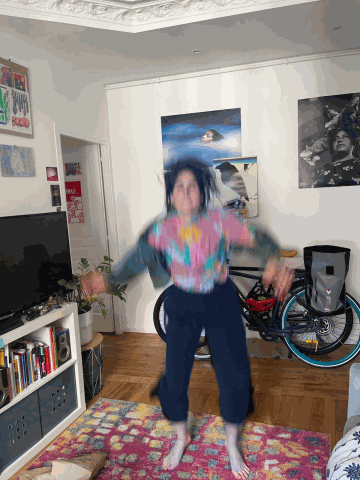

In [15]:
# Display GIF
from IPython.display import Image as IPImage
IPImage(filename=gif_output_path)

In [33]:
import cv2
import numpy as np
import os
import glob
import math
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageEnhance, ImageFilter
import imageio
import torch
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo

In [34]:
# Initialize Detectron2
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set the threshold for this model
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"  # Use CUDA if available

predictor = DefaultPredictor(cfg)

In [42]:
# Function to drastically reduce image size
def drastically_reduce_image_size(image, scale=0.3):
    """Reduce image size by a specified scale."""
    width = int(image.shape[1] * scale)
    height = int(image.shape[0] * scale)
    return cv2.resize(image, (width, height), interpolation=cv2.INTER_AREA)

def extract_and_color_silhouette(image, mask, color, opacity=0.3, use_blur=True, blur_radius=2):
    """Extract and color the silhouette with specified opacity and blur radius."""
    mask = mask.astype(np.uint8) * 255  # Convert mask to binary (0 or 255)
    silhouette = np.zeros((image.shape[0], image.shape[1], 4), dtype=np.uint8)
    cropped_image = np.zeros((image.shape[0], image.shape[1], 4), dtype=np.uint8)
    
    # Apply the mask to the original image and color the silhouette
    for c in range(3):  # For each color channel
        silhouette[:, :, c] = color[c] * (mask // 255)
        cropped_image[:, :, c] = image[:, :, c] * (mask // 255)
    
    silhouette[:, :, 3] = (mask * opacity).astype(np.uint8)  # Set alpha channel with opacity
    cropped_image[:, :, 3] = (mask * opacity).astype(np.uint8)  # Set alpha channel with opacity
    
    silhouette_img = Image.fromarray(silhouette)
    cropped_img = Image.fromarray(cropped_image)

    # Apply blur to the edges
    if use_blur:
        silhouette_img = silhouette_img.filter(ImageFilter.GaussianBlur(blur_radius))
        cropped_img = cropped_img.filter(ImageFilter.GaussianBlur(blur_radius))

    return cropped_img, silhouette_img

def remove_human_shapes(image, mask):
    """Remove human shapes from the background."""
    background = image.copy()
    background[mask == 1] = 255  # Set the masked region to white
    return background

def combine_silhouette_and_mask(cropped_img, colored_mask):
    """Combine the silhouette and colored mask without fully obscuring the silhouette."""
    combined_img = Image.alpha_composite(colored_mask, cropped_img)
    return combined_img


In [43]:
def process_images(input_folder):
    """Yield images from the input folder."""
    all_images = sorted([img for img in os.listdir(input_folder) if img.endswith('.jpg') or img.endswith('.png')])
    for img_name in all_images:
        image_path = os.path.join(input_folder, img_name)
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Drastically reduce image size
        image_resized = drastically_reduce_image_size(image)
        
        yield img_name, image_resized



In [37]:
# Step 1: Create panoramic image from all images
def create_panorama(input_folder):
    # Read and reduce Images
    imagefiles = sorted(glob.glob(f"{input_folder}{os.sep}*.jpg") + glob.glob(f"{input_folder}{os.sep}*.png"))
    images = [drastically_reduce_image_size(cv2.cvtColor(cv2.imread(img), cv2.COLOR_BGR2RGB)) for img in imagefiles]
    
    # Initialize the stitcher
    stitcher = cv2.Stitcher_create()
    status, result = stitcher.stitch(images)

    if status == 0:
        return result
    else:
        print(f"Error stitching images, status code: {status}")
        return None

In [38]:
# Directory paths
input_folder = "Desktop/GoPro_testTechnique/testNoelia"
output_folder = "Desktop/GoPro_testTechnique/out_corrected4"
human_folder = "Desktop/GoPro_testTechnique/humans4"
background_folder = "Desktop/GoPro_testTechnique/backgrounds4"
os.makedirs(output_folder, exist_ok=True)
os.makedirs(human_folder, exist_ok=True)
os.makedirs(background_folder, exist_ok=True)

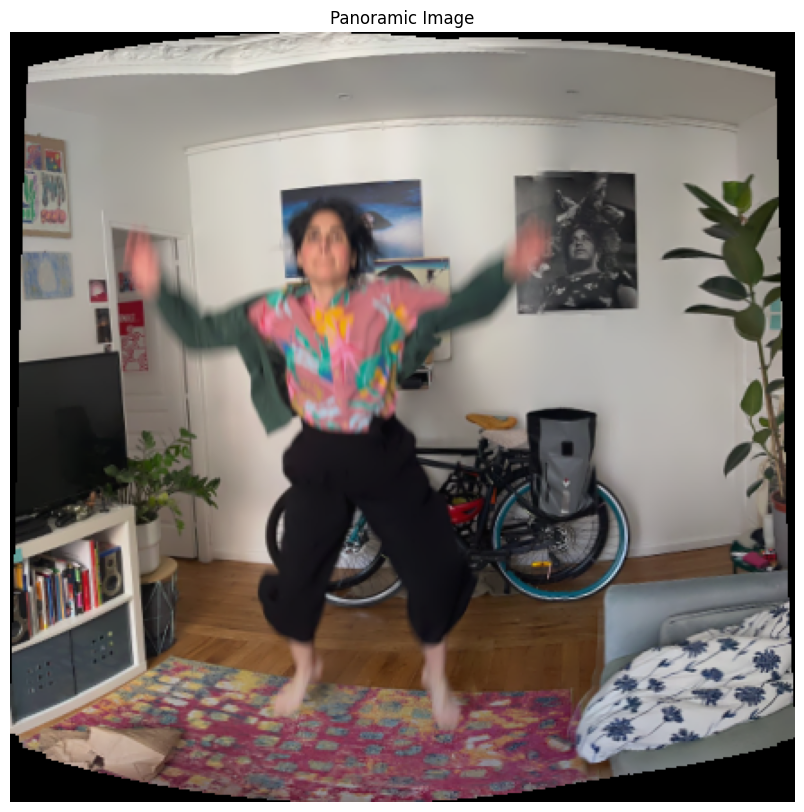

In [39]:
# Create the panoramic background
panorama_image = create_panorama(input_folder)
if panorama_image is not None:
    panorama_image_pil = Image.fromarray(panorama_image).convert("RGBA")

    # Visualize the panoramic image
    plt.figure(figsize=(20, 10))
    plt.imshow(panorama_image_pil)
    plt.title("Panoramic Image")
    plt.axis('off')
    plt.show()
else:
    print("Panorama creation failed.")

In [40]:
# Define blur radius and options
blur_radius = 2  # Adjust this value to change the blur effect on the edges
use_blur = False  # Option to use blur or not
opacity = 0.5  # Set opacity for human shapes

In [44]:
# Process each image using the generator function
for img_name, image_resized in process_images(input_folder):
    # Detect human silhouette
    outputs = predictor(image_resized)
    instances = outputs["instances"]
    human_masks = instances.pred_masks[instances.pred_classes == 0]  # Class 0 corresponds to 'person'

    if len(human_masks) > 0:
        human_mask = human_masks[0].cpu().numpy()
    else:
        continue  # Skip if no person detected

    # Extract and color the human silhouette
    color = (int(255 * np.random.random()), int(255 * np.random.random()), int(255 * np.random.random()))
    cropped_img, colored_silhouette = extract_and_color_silhouette(image_resized, human_mask, color, opacity, use_blur, blur_radius)

    # Remove human shapes from the background
    background_cropped = remove_human_shapes(image_resized, human_mask)

    # Save the cropped human shapes and backgrounds
    human_img_path = os.path.join(human_folder, f"human_{img_name}")
    background_img_path = os.path.join(background_folder, f"background_{img_name}")
    cropped_img.convert("RGB").save(human_img_path)
    Image.fromarray(background_cropped).save(background_img_path)

In [45]:
def create_gif_with_optical_flow(input_folder, output_path, panorama_image_pil, use_optical_flow=True):
    # Initialize accumulation variables
    if panorama_image_pil is not None:
        accumulated_silhouettes = Image.new("RGBA", panorama_image_pil.size, (255, 255, 255, 0))

    # Initialize SIFT detector
    sift = cv2.SIFT_create()

    # Initialize BFMatcher
    bf = cv2.BFMatcher()

    # Create a list to hold GIF frames
    gif_images = []

    # Initialize the previous frame details
    previous_image_gray = None
    previous_keypoints = None
    previous_descriptors = None
    panorama_height, panorama_width = panorama_image_pil.size

    # Process each image using the generator function
    for img_name, image_resized in process_images(input_folder):
        image_gray = cv2.cvtColor(image_resized, cv2.COLOR_RGB2GRAY)

        # Detect human silhouette
        outputs = predictor(image_resized)
        instances = outputs["instances"]
        human_masks = instances.pred_masks[instances.pred_classes == 0]  # Class 0 corresponds to 'person'

        if len(human_masks) > 0:
            human_mask = human_masks[0].cpu().numpy()
        else:
            continue  # Skip if no person detected

        # Extract and color the human silhouette
        color = (int(255 * np.random.random()), int(255 * np.random.random()), int(255 * np.random.random()))
        cropped_img, colored_silhouette = extract_and_color_silhouette(image_resized, human_mask, color, opacity, use_blur, blur_radius)

        # Combine the silhouette and colored mask
        combined_silhouette = combine_silhouette_and_mask(cropped_img, colored_silhouette)

        if use_optical_flow and previous_image_gray is not None:
            # Detect keypoints and descriptors in the current image
            keypoints, descriptors = sift.detectAndCompute(image_gray, None)

            # Match descriptors
            matches = bf.knnMatch(previous_descriptors, descriptors, k=2)

            # Apply ratio test
            good_matches = []
            for m, n in matches:
                if m.distance < 0.75 * n.distance:
                    good_matches.append(m)

            # Check if there are enough good matches
            if len(good_matches) >= 4:
                # Extract location of good matches
                points_previous = np.float32([previous_keypoints[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
                points_current = np.float32([keypoints[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)

                # Find homography
                H, mask = cv2.findHomography(points_current, points_previous, cv2.RANSAC, 5.0)

                # Warp the current frame to align with the panorama
                warped_image = cv2.warpPerspective(np.array(combined_silhouette), H, (panorama_width, panorama_height))
                warped_image_pil = Image.fromarray(warped_image)

                # Ensure the warped image is the same size as the accumulated silhouettes
                warped_image_pil = warped_image_pil.resize(accumulated_silhouettes.size)

                # Accumulate the silhouettes in the panorama space
                accumulated_silhouettes = Image.alpha_composite(accumulated_silhouettes, warped_image_pil)
            else:
                # If not enough matches, use the current image as is
                warped_image_pil = combined_silhouette.resize((panorama_width, panorama_height))
                accumulated_silhouettes = Image.alpha_composite(accumulated_silhouettes, warped_image_pil)

        else:
            # Initialize the first frame details
            accumulated_silhouettes = combined_silhouette.resize((panorama_width, panorama_height))

        # Ensure both images are the same size before compositing
        if accumulated_silhouettes.size != panorama_image_pil.size:
            accumulated_silhouettes = accumulated_silhouettes.resize(panorama_image_pil.size)

        # Combine the current frame with the accumulated silhouettes
        combined_image = Image.alpha_composite(panorama_image_pil, accumulated_silhouettes)

        # Save the combined image for the GIF
        gif_images.append(np.array(combined_image))

        # Update previous image, keypoints, and descriptors
        previous_image_gray = image_gray
        previous_keypoints, previous_descriptors = sift.detectAndCompute(previous_image_gray, None)

    # Ensure all GIF images have the same size
    max_height = max(img.shape[0] for img in gif_images)
    max_width = max(img.shape[1] for img in gif_images)
    for i in range(len(gif_images)):
        if gif_images[i].shape[0] != max_height or gif_images[i].shape[1] != max_width:
            padded_img = np.zeros((max_height, max_width, 4), dtype=np.uint8)
            padded_img[:gif_images[i].shape[0], :gif_images[i].shape[1], :] = gif_images[i]
            gif_images[i] = padded_img

    # Create GIF
    imageio.mimsave(output_path, gif_images, fps=10)  # Adjust FPS as needed

In [46]:
# Create GIF with moving panoramic background and optical flow
if panorama_image is not None:
    gif_output_path_moving_bg = os.path.join(output_folder, 'collage_animation_moving_bg.gif')
    create_gif_with_optical_flow(input_folder, gif_output_path_moving_bg, panorama_image_pil, use_optical_flow=True)

    gif_output_path_static_bg = os.path.join(output_folder, 'collage_animation_static_bg.gif')
    create_gif_with_optical_flow(input_folder, gif_output_path_static_bg, panorama_image_pil, use_optical_flow=False)

# Display GIFs
from IPython.display import Image as IPImage
IPImage(filename=gif_output_path_moving_bg), IPImage(filename=gif_output_path_static_bg)

(<IPython.core.display.Image object>, <IPython.core.display.Image object>)

In [1]:
##########################

In [18]:
import cv2
import numpy as np
import os
import glob
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageEnhance, ImageFilter
import imageio
import torch
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from IPython.display import Image as IPImage, display

In [19]:
def drastically_reduce_image_size(image, scale=0.3):
    """Reduce image size by a specified scale."""
    width = int(image.shape[1] * scale)
    height = int(image.shape[0] * scale)
    return cv2.resize(image, (width, height), interpolation=cv2.INTER_AREA)


In [20]:
def extract_and_color_silhouette(image, mask, color, opacity=0.3, use_blur=True, blur_radius=2):
    """Extract and color the silhouette with specified opacity and blur radius."""
    mask = mask.astype(np.uint8) * 255  # Convert mask to binary (0 or 255)
    silhouette = np.zeros((image.shape[0], image.shape[1], 4), dtype=np.uint8)
    cropped_image = np.zeros((image.shape[0], image.shape[1], 4), dtype=np.uint8)
    
    # Apply the mask to the original image and color the silhouette
    for c in range(3):  # For each color channel
        silhouette[:, :, c] = color[c] * (mask // 255)
        cropped_image[:, :, c] = image[:, :, c] * (mask // 255)
    
    silhouette[:, :, 3] = (mask * opacity).astype(np.uint8)  # Set alpha channel with opacity
    cropped_image[:, :, 3] = (mask * opacity).astype(np.uint8)  # Set alpha channel with opacity
    
    silhouette_img = Image.fromarray(silhouette)
    cropped_img = Image.fromarray(cropped_image)

    # Apply blur to the edges
    if use_blur:
        silhouette_img = silhouette_img.filter(ImageFilter.GaussianBlur(blur_radius))
        cropped_img = cropped_img.filter(ImageFilter.GaussianBlur(blur_radius))

    return cropped_img, silhouette_img


In [21]:
def remove_human_shapes(image, mask):
    """Remove human shapes from the background."""
    background = image.copy()
    background[mask == 1] = 255  # Set the masked region to white
    return background


In [22]:
def combine_silhouette_and_mask(cropped_img, colored_mask):
    """Combine the silhouette and colored mask without fully obscuring the silhouette."""
    combined_img = Image.alpha_composite(colored_mask, cropped_img)
    return combined_img


In [23]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set the threshold for this model
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"  # Use CUDA if available

predictor = DefaultPredictor(cfg)


In [24]:
def process_images(input_folder):
    """Yield images from the input folder."""
    all_images = sorted([img for img in os.listdir(input_folder) if img.endswith('.jpg') or img.endswith('.png')])
    for img_name in all_images:
        image_path = os.path.join(input_folder, img_name)
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Drastically reduce image size
        image_resized = drastically_reduce_image_size(image)
        
        yield img_name, image_resized


In [25]:
# Directory paths
input_folder = "Desktop/GoPro_testTechnique/testNoelia"
output_folder = "Desktop/GoPro_testTechnique/out_corrected4"
human_folder = "Desktop/GoPro_testTechnique/humans4"
background_folder = "Desktop/GoPro_testTechnique/backgrounds4"
os.makedirs(output_folder, exist_ok=True)
os.makedirs(human_folder, exist_ok=True)
os.makedirs(background_folder, exist_ok=True)

In [26]:
# Parameters
blur_radius = 2  # Adjust this value to change the blur effect on the edges
opacity = 0.3  # Adjust opacity as needed
use_blur = True  # Set to False if you do not want to use blur


In [27]:
# Process each image using the generator function
for img_name, image_resized in process_images(input_folder):
    # Detect human silhouette
    outputs = predictor(image_resized)
    instances = outputs["instances"]
    human_masks = instances.pred_masks[instances.pred_classes == 0]  # Class 0 corresponds to 'person'

    if len(human_masks) > 0:
        human_mask = human_masks[0].cpu().numpy()
    else:
        continue  # Skip if no person detected

    # Extract and color the human silhouette
    color = (int(255 * np.random.random()), int(255 * np.random.random()), int(255 * np.random.random()))
    cropped_img, colored_silhouette = extract_and_color_silhouette(image_resized, human_mask, color, opacity, use_blur, blur_radius)

    # Remove human shapes from the background
    background_cropped = remove_human_shapes(image_resized, human_mask)

    # Save the cropped human shapes and backgrounds
    human_img_path = os.path.join(human_folder, f"human_{img_name}")
    background_img_path = os.path.join(background_folder, f"background_{img_name}")
    cropped_img.convert("RGB").save(human_img_path)
    Image.fromarray(background_cropped).convert("RGB").save(background_img_path)


In [28]:
# Create panoramic image from all images
def create_panorama(input_folder):
    # Read and reduce Images
    imagefiles = sorted(glob.glob(f"{input_folder}{os.sep}*.jpg") + glob.glob(f"{input_folder}{os.sep}*.png"))
    images = [drastically_reduce_image_size(cv2.cvtColor(cv2.imread(img), cv2.COLOR_BGR2RGB)) for img in imagefiles]
    
    # Initialize the stitcher
    stitcher = cv2.Stitcher_create()
    status, result = stitcher.stitch(images)

    if status == 0:
        return result
    else:
        print(f"Error stitching images, status code: {status}")
        return None

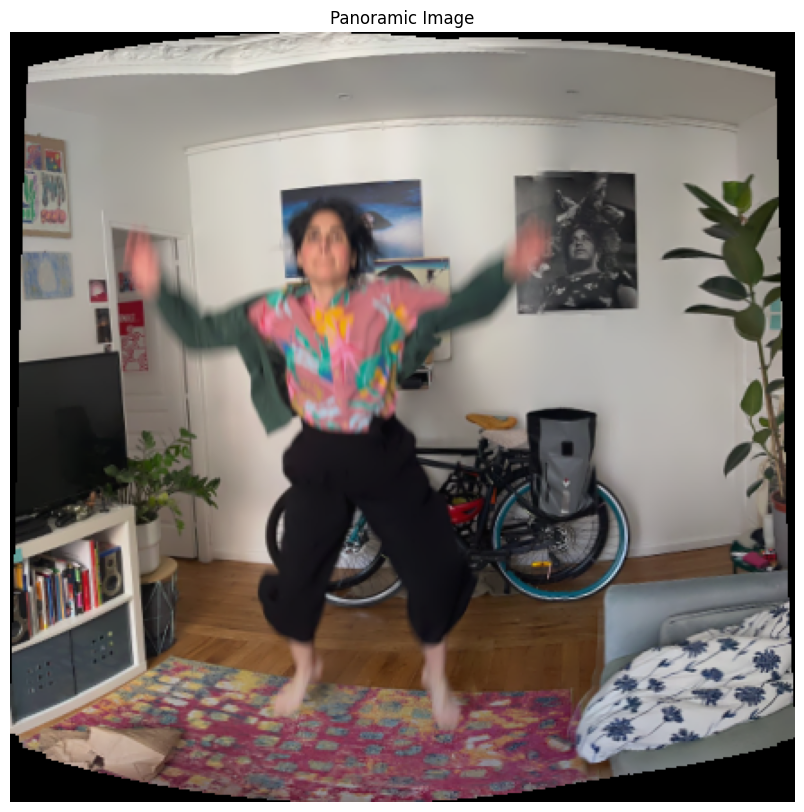

In [29]:
# Create the panoramic background
panorama_image = create_panorama(input_folder)
if panorama_image is not None:
    panorama_image_pil = Image.fromarray(panorama_image).convert("RGBA")

    # Visualize the panoramic image
    plt.figure(figsize=(20, 10))
    plt.imshow(panorama_image_pil)
    plt.title("Panoramic Image")
    plt.axis('off')
    plt.show()
else:
    print("Panorama creation failed.")

In [30]:
def create_gif_with_optical_flow(input_folder, output_path, use_optical_flow=True):
    # Initialize accumulation variables
    accumulated_silhouettes = None
    previous_image_gray = None
    previous_keypoints = None
    previous_descriptors = None

    # Initialize SIFT detector
    sift = cv2.SIFT_create()

    # Initialize BFMatcher
    bf = cv2.BFMatcher()

    # Create a list to hold GIF frames
    gif_images = []

    # Process each image using the generator function
    for img_name, image_resized in process_images(input_folder):
        image_gray = cv2.cvtColor(image_resized, cv2.COLOR_RGB2GRAY)

        if accumulated_silhouettes is None:
            accumulated_silhouettes = Image.new("RGBA", Image.fromarray(image_resized).size, (255, 255, 255, 0))
            previous_image_gray = image_gray
            previous_keypoints, previous_descriptors = sift.detectAndCompute(previous_image_gray, None)

        # Detect human silhouette
        outputs = predictor(image_resized)
        instances = outputs["instances"]
        human_masks = instances.pred_masks[instances.pred_classes == 0]  # Class 0 corresponds to 'person'

        if len(human_masks) > 0:
            human_mask = human_masks[0].cpu().numpy()
        else:
            continue  # Skip if no person detected

        # Extract and color the human silhouette
        color = (int(255 * np.random.random()), int(255 * np.random.random()), int(255 * np.random.random()))
        cropped_img, colored_silhouette = extract_and_color_silhouette(image_resized, human_mask, color, opacity, use_blur, blur_radius)

        # Combine the silhouette and colored mask
        combined_silhouette = combine_silhouette_and_mask(cropped_img, colored_silhouette)

        if use_optical_flow and previous_image_gray is not None:
            # Detect keypoints and descriptors in the current image
            keypoints, descriptors = sift.detectAndCompute(image_gray, None)

            # Match descriptors
            matches = bf.knnMatch(previous_descriptors, descriptors, k=2)

            # Apply ratio test
            good_matches = []
            for m, n in matches:
                if m.distance < 0.75 * n.distance:
                    good_matches.append(m)

            # Check if there are enough good matches
            if len(good_matches) >= 4:
                # Extract location of good matches
                points_previous = np.float32([previous_keypoints[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
                points_current = np.float32([keypoints[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)

                # Find homography
                H, mask = cv2.findHomography(points_current, points_previous, cv2.RANSAC, 5.0)

                # Warp the accumulated silhouettes to align with the current image
                accumulated_silhouettes = accumulated_silhouettes.transform(
                    Image.fromarray(image_resized).size,
                    Image.PERSPECTIVE,
                    data=H.flatten()[:8],
                    resample=Image.BILINEAR
                )

        # Ensure the combined silhouette is the same size as the accumulated silhouettes
        combined_silhouette = combined_silhouette.resize(accumulated_silhouettes.size)

        # Accumulate the combined silhouette
        accumulated_silhouettes = Image.alpha_composite(accumulated_silhouettes, combined_silhouette)

        # Combine the current frame with the accumulated silhouettes
        combined_image = Image.alpha_composite(Image.fromarray(image_resized).convert("RGBA"), accumulated_silhouettes)

        # Save the combined image for the GIF
        gif_images.append(np.array(combined_image))

        # Update previous image, keypoints, and descriptors
        if use_optical_flow:
            previous_image_gray = image_gray
            previous_keypoints, previous_descriptors = sift.detectAndCompute(previous_image_gray, None)

    # Ensure all GIF images have the same size
    max_height = max(img.shape[0] for img in gif_images)
    max_width = max(img.shape[1] for img in gif_images)
    for i in range(len(gif_images)):
        if gif_images[i].shape[0] != max_height or gif_images[i].shape[1] != max_width:
            padded_img = np.zeros((max_height, max_width, 4), dtype=np.uint8)
            padded_img[:gif_images[i].shape[0], :gif_images[i].shape[1], :] = gif_images[i]
            gif_images[i] = padded_img

    # Create GIF
    imageio.mimsave(output_path, gif_images, fps=10)  # Adjust FPS as needed

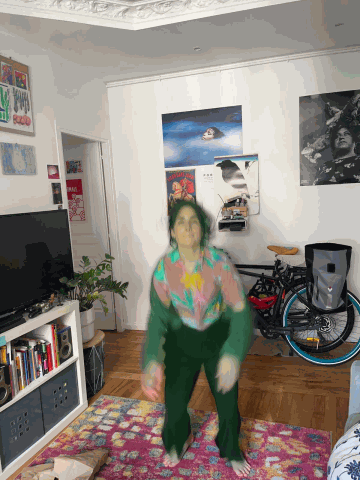

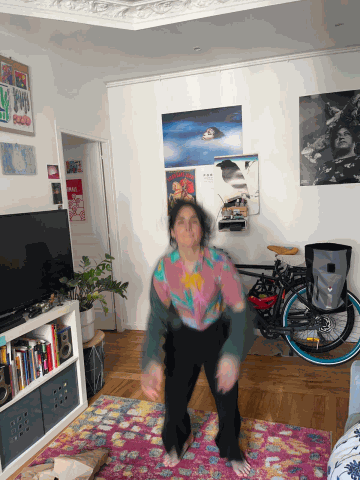

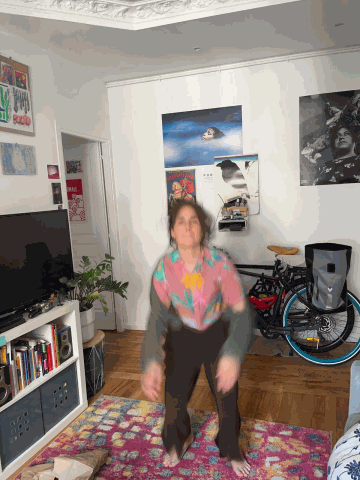

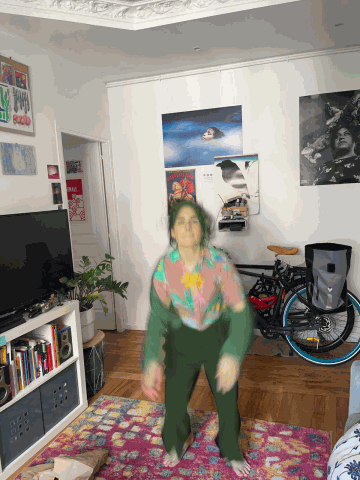

In [31]:
# Create GIF with moving background and camera tracking
gif_output_path_changing_bg_moving = os.path.join(output_folder, 'collage_animation_changing_bg_moving.gif')
create_gif_with_optical_flow(input_folder, gif_output_path_changing_bg_moving, use_optical_flow=True)

# Create GIF with changing background without camera tracking
gif_output_path_changing_bg_static = os.path.join(output_folder, 'collage_animation_changing_bg_static.gif')
create_gif_with_optical_flow(input_folder, gif_output_path_changing_bg_static, use_optical_flow=False)

# Create GIF with moving panoramic background and optical flow
if panorama_image is not None:
    gif_output_path_moving_bg = os.path.join(output_folder, 'collage_animation_moving_bg.gif')
    create_gif_with_optical_flow(input_folder, gif_output_path_moving_bg, use_optical_flow=True)

    gif_output_path_static_bg = os.path.join(output_folder, 'collage_animation_static_bg.gif')
    create_gif_with_optical_flow(input_folder, gif_output_path_static_bg, use_optical_flow=False)

# Display GIFs
display(IPImage(filename=gif_output_path_changing_bg_moving))
display(IPImage(filename=gif_output_path_changing_bg_static))
if panorama_image is not None:
    display(IPImage(filename=gif_output_path_moving_bg))
    display(IPImage(filename=gif_output_path_static_bg))

In [1]:
###########################

In [1]:
import cv2
import numpy as np
import os
import glob
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageEnhance, ImageFilter
import imageio
import torch
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from IPython.display import Image as IPImage, display

In [3]:
# Directory paths
input_folder = "Desktop/GoPro_testTechnique/testNoelia"
output_folder = "Desktop/GoPro_testTechnique/out_corrected5"
human_folder = "Desktop/GoPro_testTechnique/humans5"
background_folder = "Desktop/GoPro_testTechnique/backgrounds5"
os.makedirs(output_folder, exist_ok=True)
os.makedirs(human_folder, exist_ok=True)
os.makedirs(background_folder, exist_ok=True)

In [4]:
# Initialize Detectron2
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set the threshold for this model
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"  # Use CUDA if available

predictor = DefaultPredictor(cfg)

In [5]:
# Function to drastically reduce image size
def drastically_reduce_image_size(image, scale=0.3):
    """Reduce image size by a specified scale."""
    width = int(image.shape[1] * scale)
    height = int(image.shape[0] * scale)
    return cv2.resize(image, (width, height), interpolation=cv2.INTER_AREA)

# Function to extract, crop, and color the silhouette
def extract_and_color_silhouette(image, mask, color, opacity=0.3, blur_radius=0, apply_blur=False):
    """Extract and color the silhouette with specified opacity and blur radius."""
    mask = mask.astype(np.uint8) * 255  # Convert mask to binary (0 or 255)
    silhouette = np.zeros((image.shape[0], image.shape[1], 4), dtype=np.uint8)
    cropped_image = np.zeros((image.shape[0], image.shape[1], 4), dtype=np.uint8)
    background_cropped = image.copy()

    # Apply the mask to the original image and color the silhouette
    for c in range(3):  # For each color channel
        silhouette[:, :, c] = color[c] * (mask // 255)
        cropped_image[:, :, c] = image[:, :, c] * (mask // 255)
        background_cropped[:, :, c] = background_cropped[:, :, c] * (1 - (mask // 255))

    silhouette[:, :, 3] = (mask * opacity).astype(np.uint8)  # Set alpha channel with opacity
    cropped_image[:, :, 3] = (mask * opacity).astype(np.uint8)  # Set alpha channel with opacity
    
    silhouette_img = Image.fromarray(silhouette)
    cropped_img = Image.fromarray(cropped_image)
    background_cropped_img = Image.fromarray(background_cropped)

    if apply_blur:
        silhouette_img = silhouette_img.filter(ImageFilter.GaussianBlur(blur_radius))
        cropped_img = cropped_img.filter(ImageFilter.GaussianBlur(blur_radius))
        background_cropped_img = background_cropped_img.filter(ImageFilter.GaussianBlur(blur_radius))

    return cropped_img, silhouette_img, background_cropped_img

# Generator function to process images in the input folder
def process_images(input_folder):
    """Yield images from the input folder."""
    all_images = sorted([img for img in os.listdir(input_folder) if img.endswith('.jpg') or img.endswith('.png')])
    for img_name in all_images:
        image_path = os.path.join(input_folder, img_name)
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Drastically reduce image size
        image_resized = drastically_reduce_image_size(image)
        
        yield img_name, image_resized

In [6]:
for img_name, image_resized in process_images(input_folder):
    outputs = predictor(image_resized)
    instances = outputs["instances"]
    human_masks = instances.pred_masks[instances.pred_classes == 0]  # Class 0 corresponds to 'person'

    if len(human_masks) > 0:
        human_mask = human_masks[0].cpu().numpy()
    else:
        continue  # Skip if no person detected

    color = (int(255 * np.random.random()), int(255 * np.random.random()), int(255 * np.random.random()))
    cropped_img, colored_silhouette, background_cropped_img = extract_and_color_silhouette(image_resized, human_mask, color, opacity=0.3, blur_radius=0, apply_blur=False)

    human_img_path = os.path.join(human_folder, f"human_{img_name}")
    background_img_path = os.path.join(background_folder, f"background_{img_name}")
    cropped_img.convert("RGB").save(human_img_path)
    background_cropped_img.save(background_img_path)

C:\Users\Isadora\anaconda3\envs\rafalesSegmentation_Py310\lib\site-packages\torch\functional.py:512: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\TensorShape.cpp:3588.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


In [7]:
def create_panorama(input_folder):
    imagefiles = sorted(glob.glob(f"{input_folder}{os.sep}*.jpg") + glob.glob(f"{input_folder}{os.sep}*.png"))
    images = [drastically_reduce_image_size(cv2.cvtColor(cv2.imread(img), cv2.COLOR_BGR2RGB)) for img in imagefiles]

    stitcher = cv2.Stitcher_create()
    status, result = stitcher.stitch(images)

    if status == 0:
        return result
    else:
        print(f"Error stitching images, status code: {status}")
        return None

panorama_image = create_panorama(input_folder)
if panorama_image is not None:
    panorama_image_pil = Image.fromarray(panorama_image).convert("RGBA")

In [9]:
def create_gif_with_optical_flow(input_folder, output_path, use_optical_flow):
    sift = cv2.SIFT_create()
    bf = cv2.BFMatcher()
    accumulated_silhouettes = None
    previous_image_gray = None
    previous_keypoints = None
    previous_descriptors = None
    gif_images = []

    for img_name, image_resized in process_images(input_folder):
        image_gray = cv2.cvtColor(image_resized, cv2.COLOR_RGB2GRAY)
        outputs = predictor(image_resized)
        instances = outputs["instances"]
        human_masks = instances.pred_masks[instances.pred_classes == 0]

        if len(human_masks) > 0:
            human_mask = human_masks[0].cpu().numpy()
        else:
            continue

        color = (int(255 * np.random.random()), int(255 * np.random.random()), int(255 * np.random.random()))
        cropped_img, colored_silhouette, _ = extract_and_color_silhouette(image_resized, human_mask, color, opacity=0.3, blur_radius=0, apply_blur=False)

        combined_silhouette = Image.alpha_composite(colored_silhouette, cropped_img)

        if accumulated_silhouettes is None:
            accumulated_silhouettes = Image.new("RGBA", combined_silhouette.size, (255, 255, 255, 0))
            previous_image_gray = image_gray
            previous_keypoints, previous_descriptors = sift.detectAndCompute(previous_image_gray, None)
            continue

        if use_optical_flow and previous_descriptors is not None:
            keypoints, descriptors = sift.detectAndCompute(image_gray, None)
            matches = bf.knnMatch(previous_descriptors, descriptors, k=2)
            good_matches = [m for m, n in matches if m.distance < 0.75 * n.distance]

            if len(good_matches) >= 4:
                points_previous = np.float32([previous_keypoints[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
                points_current = np.float32([keypoints[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)
                H, mask = cv2.findHomography(points_current, points_previous, cv2.RANSAC, 5.0)
                accumulated_silhouettes = accumulated_silhouettes.transform(
                    combined_silhouette.size,
                    Image.PERSPECTIVE,
                    data=H.flatten()[:8],
                    resample=Image.BILINEAR
                )

        accumulated_silhouettes = Image.alpha_composite(accumulated_silhouettes, combined_silhouette)
        combined_image = Image.alpha_composite(Image.fromarray(image_resized).convert("RGBA"), accumulated_silhouettes)
        gif_images.append(np.array(combined_image))

        previous_image_gray = image_gray
        previous_keypoints, previous_descriptors = sift.detectAndCompute(previous_image_gray, None)

    max_height = max(img.shape[0] for img in gif_images)
    max_width = max(img.shape[1] for img in gif_images)
    for i in range(len(gif_images)):
        if gif_images[i].shape[0] != max_height or gif_images[i].shape[1] != max_width:
            padded_img = np.zeros((max_height, max_width, 4), dtype=np.uint8)
            padded_img[:gif_images[i].shape[0], :gif_images[i].shape[1], :] = gif_images[i]
            gif_images[i] = padded_img

    imageio.mimsave(output_path, gif_images, fps=8)

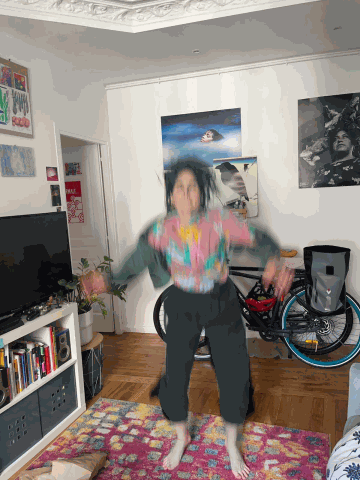

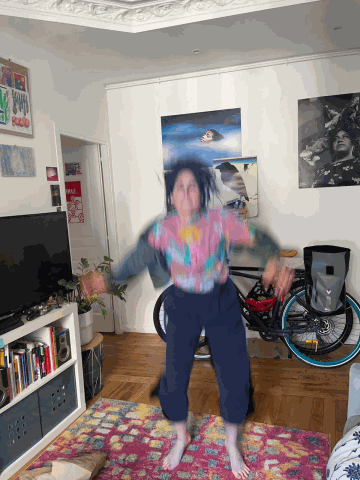

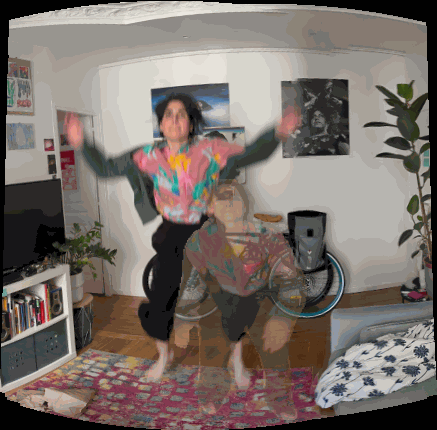

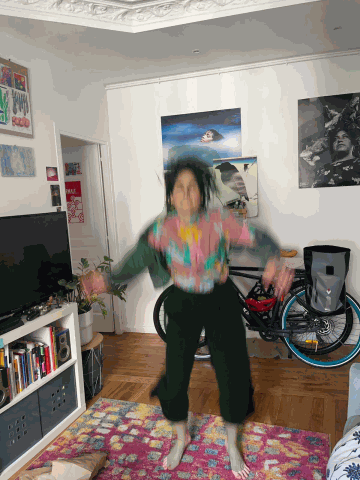

In [10]:
# Create GIF with changing background without camera tracking
gif_output_path_changing_bg_static = os.path.join(output_folder, 'collage_animation_changing_bg_static.gif')
create_gif_with_optical_flow(input_folder, gif_output_path_changing_bg_static, use_optical_flow=False)
display(IPImage(filename=gif_output_path_changing_bg_static))

# Create GIF with moving background and camera tracking
gif_output_path_changing_bg_moving = os.path.join(output_folder, 'collage_animation_changing_bg_moving.gif')
create_gif_with_optical_flow(input_folder, gif_output_path_changing_bg_moving, use_optical_flow=True)
display(IPImage(filename=gif_output_path_changing_bg_moving))

# Create GIF with moving panoramic background and optical flow
if panorama_image is not None:
    gif_output_path_static_bg = os.path.join(output_folder, 'collage_animation_static_bg.gif')
    gif_images_static_bg = []

    accumulated_silhouettes_static = Image.new("RGBA", panorama_image_pil.size, (255, 255, 255, 0))
    for img_name, image_resized in process_images(input_folder):
        outputs = predictor(image_resized)
        instances = outputs["instances"]
        human_masks = instances.pred_masks[instances.pred_classes == 0]

        if len(human_masks) > 0:
            human_mask = human_masks[0].cpu().numpy()
        else:
            continue

        color = (int(255 * np.random.random()), int(255 * np.random.random()), int(255 * np.random.random()))
        cropped_img, colored_silhouette, _ = extract_and_color_silhouette(image_resized, human_mask, color, opacity=0.3, blur_radius=0, apply_blur=False)
        combined_silhouette = Image.alpha_composite(colored_silhouette, cropped_img)
        combined_silhouette = combined_silhouette.resize(panorama_image_pil.size)

        accumulated_silhouettes_static = Image.alpha_composite(accumulated_silhouettes_static, combined_silhouette)
        combined_image_static = Image.alpha_composite(panorama_image_pil, accumulated_silhouettes_static)
        gif_images_static_bg.append(np.array(combined_image_static))

    imageio.mimsave(gif_output_path_static_bg, gif_images_static_bg, fps=8)
    display(IPImage(filename=gif_output_path_static_bg))

    gif_output_path_moving_bg = os.path.join(output_folder, 'collage_animation_moving_bg.gif')
    create_gif_with_optical_flow(input_folder, gif_output_path_moving_bg, use_optical_flow=True)
    display(IPImage(filename=gif_output_path_moving_bg))